# Bank Marketing Data Set

## Goal
Using the data collected from existing customers, build a model that will help the marketing team identify potential customers who are relatively more likely to subscribe term deposit and thus increase their hit ratio.

## Attribute Information:

#### Bank client data:
1. age (numeric)
2. job : type of job (categorical: 'admin.','blue-collar','entrepreneur','housemaid','management','retired','self-employed','services','student','technician','unemployed','unknown')
3. marital : marital status (categorical: 'divorced','married','single','unknown'; note: 'divorced' means divorced or widowed)
4. education (categorical:  'basic.4y','basic.6y','basic.9y','high.school','illiterate','professional.course','university.degree','unknown')
5. default: has credit in default? (categorical: 'no','yes','unknown')
6. balance: balance in account
7. housing: has housing loan? (categorical: 'no','yes','unknown')
8. loan: has personal loan? (categorical: 'no','yes','unknown')

#### Related with the last contact of the current campaign:
9. contact: contact communication type (categorical: 'cellular','telephone')
10. month: last contact month of year (categorical: 'jan', 'feb', 'mar', ..., 'nov', 'dec')
11. day: last contact day of the month
12. duration: last contact duration, in seconds (numeric). Important note: this attribute highly affects the output target (e.g., if duration=0 then y='no'). Yet, the duration is not known before a call is performed. Also, after the end of the call y is obviously known. Thus, this input should only be included for benchmark purposes and should be discarded if the intention is to have a realistic predictive model.

#### Other attributes:
13. campaign: number of contacts performed during this campaign and for this client (numeric, includes last contact)
14. pdays: number of days that passed by after the client was last contacted from a previous campaign (-1 tells us the person has not been contacted or contact period is beyond 900 days)
15. previous: number of contacts performed before this campaign and for this client (numeric)
16. poutcome: outcome of the previous marketing campaign (categorical: 'failure','nonexistent','success')

#### Output variable (desired target):
17. Target: Tell us has the client subscribed a term deposit. (Yes, No)

----


### Deliverable – 1 (Exploratory data quality report reflecting the following) – (20)
1. Univariate analysis (12 marks)
    - Univariate analysis – data types and description of the independent attributes which should include (name, meaning, range of values observed, central values (mean and median), standard deviation and quartiles, analysis of the body of distributions / tails, missing values, outliers.
    - Strategies to address the different data challenges such as data pollution, outlier’s treatment and missing values treatment.
    - Please provide comments in jupyter notebook regarding the steps you take and insights drawn from the plots.

2. Multivariate analysis (8 marks)
    - Bi-variate analysis between the predictor variables and target column. Comment on your findings in terms of their relationship and degree of relation if any. Visualize the analysis using boxplots and pair plots, histograms or density curves. Select the most appropriate attributes.
    - Please provide comments in jupyter notebook regarding the steps you take and insights drawn from the plots

### Deliverable – 2 (Prepare the data for analytics) – (10)
1. Ensure the attribute types are correct. If not, take appropriate actions.
2. Get the data model ready.
3. Transform the data i.e. scale / normalize if required
4. Create the training set and test set in ratio of 70:30

### Deliverable – 3 (create the ensemble model) – (30)
1. First create models using Logistic Regression and Decision Tree algorithm. Note the model performance by using different matrices. Use confusion matrix to evaluate class level metrics i.e. Precision/Recall. Also reflect the accuracy and F1 score of the model. (10 marks)
2. Build the ensemble models (Bagging and Boosting) and note the model performance by using different matrices. Use same metrics as in above model. (at least 3 algorithms) (15 marks)
3. Make a DataFrame to compare models and their metrics. Give conclusion regarding the best algorithm and your reason behind it. (5 marks)

In [3]:
import warnings
warnings.filterwarnings('ignore')

import pandas as pd
import numpy as np

import matplotlib.pyplot as plt
%matplotlib inline

import seaborn as sns
sns.set_style(style='darkgrid')

import plotly.express as px

from sklearn.model_selection import train_test_split as tts

from sklearn import tree
from sklearn import metrics as mtr


In [4]:
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import cross_validate

from yellowbrick.classifier import ROCAUC

In [5]:
pd.options.display.float_format = '{:,.4f}'.format        

from IPython.core.display import display, HTML
display(HTML("<style>.container { width:80% !important; }</style>"))

In [6]:
df = pd.read_csv('bank-full.csv')

In [7]:
df.head()

,age,job,marital,education,default,balance,housing,loan,contact,day,month,duration,campaign,pdays,previous,poutcome,Target
0,58,management,married,tertiary,no,2143,yes,no,unknown,5,may,261,1,-1,0,unknown,no
1,44,technician,single,secondary,no,29,yes,no,unknown,5,may,151,1,-1,0,unknown,no
2,33,entrepreneur,married,secondary,no,2,yes,yes,unknown,5,may,76,1,-1,0,unknown,no
3,47,blue-collar,married,unknown,no,1506,yes,no,unknown,5,may,92,1,-1,0,unknown,no
4,33,unknown,single,unknown,no,1,no,no,unknown,5,may,198,1,-1,0,unknown,no


In [8]:
df.rename(columns={'Target':'target'}, inplace=True)

In [9]:
df.shape

(45211, 17)

In [10]:
df[df.duration == 0]

,age,job,marital,education,default,balance,housing,loan,contact,day,month,duration,campaign,pdays,previous,poutcome,target
6424,53,management,married,primary,no,351,yes,no,unknown,27,may,0,4,-1,0,unknown,no
22937,35,technician,married,secondary,no,5535,no,no,cellular,26,aug,0,15,-1,0,unknown,no
36425,31,entrepreneur,married,secondary,no,162,yes,yes,cellular,11,may,0,2,-1,0,unknown,no


In [11]:
# Dropping observations where the duration is 'zero' so as to not influence the model
df.drop(df[df.duration == 0].index, axis=0, inplace=True)
dfM = df.copy()

# Deliverable1 - EDA

## Univariate analysis (12 marks)

1. Univariate analysis – data types and description of the independent attributes which should include (name, meaning, range of values observed, central values (mean and median), standard deviation and quartiles, analysis of the body of distributions / tails, missing values, outliers.
2. Strategies to address the different data challenges such as data pollution, outlier’s treatment and missing values treatment.
3. Please provide comments in jupyter notebook regarding the steps you take and insights drawn from the plots.

### Number of observations, the data-types and if they are null/not-null info

In [12]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 45208 entries, 0 to 45210
Data columns (total 17 columns):
age          45208 non-null int64
job          45208 non-null object
marital      45208 non-null object
education    45208 non-null object
default      45208 non-null object
balance      45208 non-null int64
housing      45208 non-null object
loan         45208 non-null object
contact      45208 non-null object
day          45208 non-null int64
month        45208 non-null object
duration     45208 non-null int64
campaign     45208 non-null int64
pdays        45208 non-null int64
previous     45208 non-null int64
poutcome     45208 non-null object
target       45208 non-null object
dtypes: int64(7), object(10)
memory usage: 6.2+ MB


### Explicit checking for NULLs

In [13]:
df.isnull().sum()

age          0
job          0
marital      0
education    0
default      0
balance      0
housing      0
loan         0
contact      0
day          0
month        0
duration     0
campaign     0
pdays        0
previous     0
poutcome     0
target       0
dtype: int64

####  Inference: No 'NULL' values in the data-set, hence no corrections are necessary


<br>

### Checking for 'zero' values to determine missing data or if the 'zeros' are part of the data

In [14]:
df[df==0].count()

age              0
job              0
marital          0
education        0
default          0
balance       3514
housing          0
loan             0
contact          0
day              0
month            0
duration         0
campaign         0
pdays            0
previous     36951
poutcome         0
target           0
dtype: int64

#### Inference: Zero values in 'balance' feature and in 'previous' feature are valid data hence no corrections are necessary


<br>

### Five-number summary for the dataset

In [15]:
df.describe(include='all').T

,count,unique,top,freq,mean,std,min,25%,50%,75%,max
age,"45,208.0000",NaN,NaN,NaN,40.9363,10.6188,18.0000,33.0000,39.0000,48.0000,95.0000
job,45208,12,blue-collar,9732,NaN,NaN,NaN,NaN,NaN,NaN,NaN
marital,45208,3,married,27211,NaN,NaN,NaN,NaN,NaN,NaN,NaN
education,45208,4,secondary,23200,NaN,NaN,NaN,NaN,NaN,NaN,NaN
default,45208,2,no,44393,NaN,NaN,NaN,NaN,NaN,NaN,NaN
balance,"45,208.0000",NaN,NaN,NaN,"1,362.2287","3,044.7947","-8,019.0000",72.0000,448.0000,"1,428.0000","102,127.0000"
housing,45208,2,yes,25128,NaN,NaN,NaN,NaN,NaN,NaN,NaN
loan,45208,2,no,37965,NaN,NaN,NaN,NaN,NaN,NaN,NaN
contact,45208,3,cellular,29283,NaN,NaN,NaN,NaN,NaN,NaN,NaN
day,"45,208.0000",NaN,NaN,NaN,15.8061,8.3224,1.0000,8.0000,16.0000,21.0000,31.0000


#### Inference: There is heavy skewness (right) with the following features: balance, duration, campaign, pdays and previous


<br>

### Summary view of distribution of all continous variables in the data-set

array([[<matplotlib.axes._subplots.AxesSubplot object at 0x000001EB73CFE0F0>,
      dtype=object)

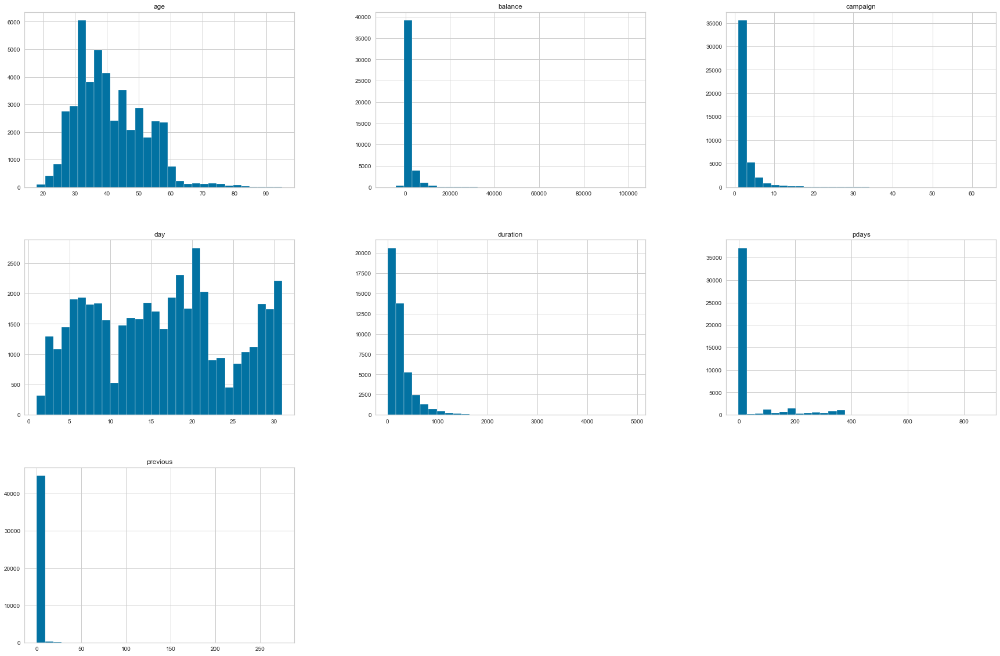

In [16]:

df.hist(bins=30, figsize=[30,20])

### Inference:
1. Day is evenly distributed (as expected)
2. Age is close to normal distribution (as expected)
3. Rest of the continuous variables (balance, campaign, pdays, previous & duration) are heavily skewed right. 


### Data-set management strategy:

1. No NULLs or Zeros in the data-set which is a good thing; hence no cleansing necessary. 
2. The issue to be tackled is the heavy data skewness and the strategy that I'm employing is to convert these heavily skewed continuous variables into categorical variables and have them 1-hot-encoded
3. Analysing individual features will help create the appropriate buckets for this continuous to categorical variable conversion


<br>


## 2. Multivariate analysis (8 marks)
- Bi-variate analysis between the predictor variables and target column. Comment on your findings in terms of their relationship and degree of relation if any. Visualize the analysis using boxplots and pair plots, histograms or density curves. Select the most appropriate attributes.
- Please provide comments in jupyter notebook regarding the steps you take and insights drawn from the plots

### Comparing features against one another for the two possible outcomes (target)

<Figure size 2160x1440 with 0 Axes>

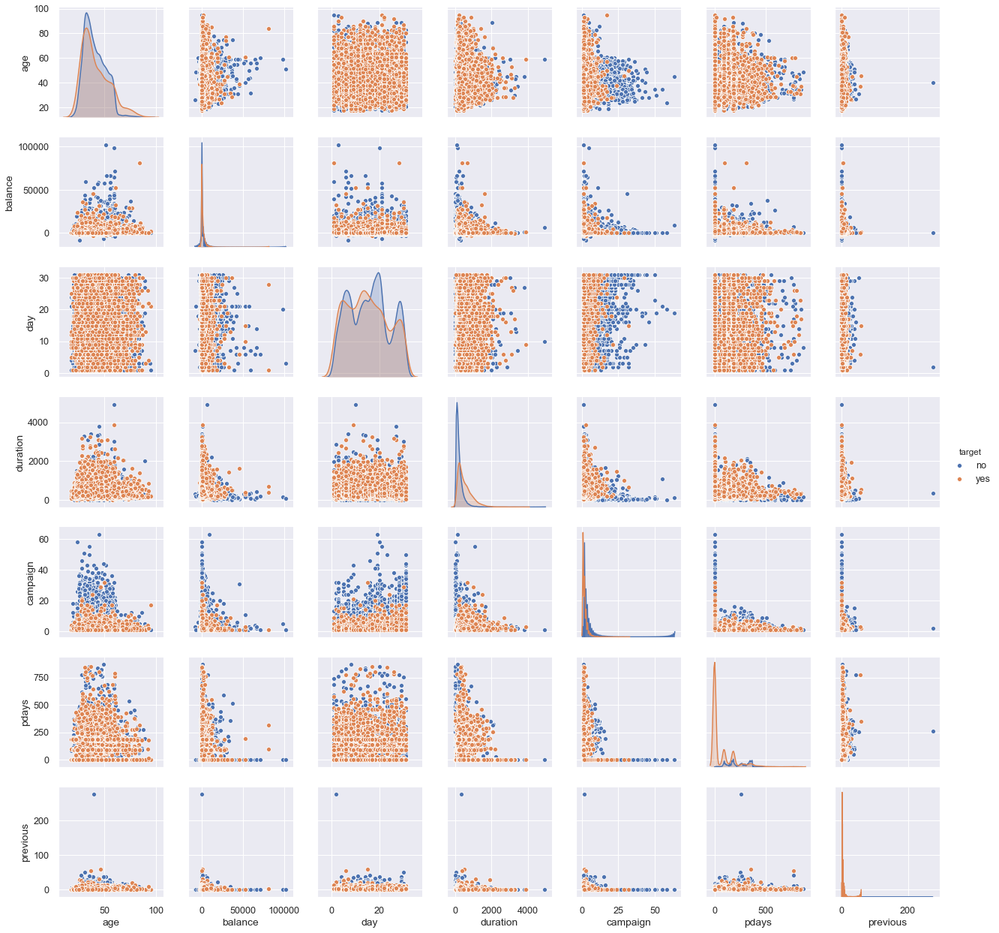

In [17]:
plt.figure(figsize=[30,20])
sns.set(font_scale=1.15)
sns.pairplot(dfM, hue='target')
plt.show()

#### Observations:
1. There is a lot more campaign effort for consumers at the lower age spectrum compared to older consumers, however there are equally higher number of non-conversions (target = no)
2. Age profile of consumers is similar between the two outcomes
3. Day of month distribution is multi-modal - understandable based on the weekends interpersing through the month
4. Consumer with target=yes have the characteristic trait of showing highest spike in lower end of the spectrum (which also includes -1 potentially indicating no contact)
5. Similar (to #4) observation with the feature 'previous' showing highest spike in lower end of the spectrum (no previous contact)

<br>

### Analysing the correlation between the features

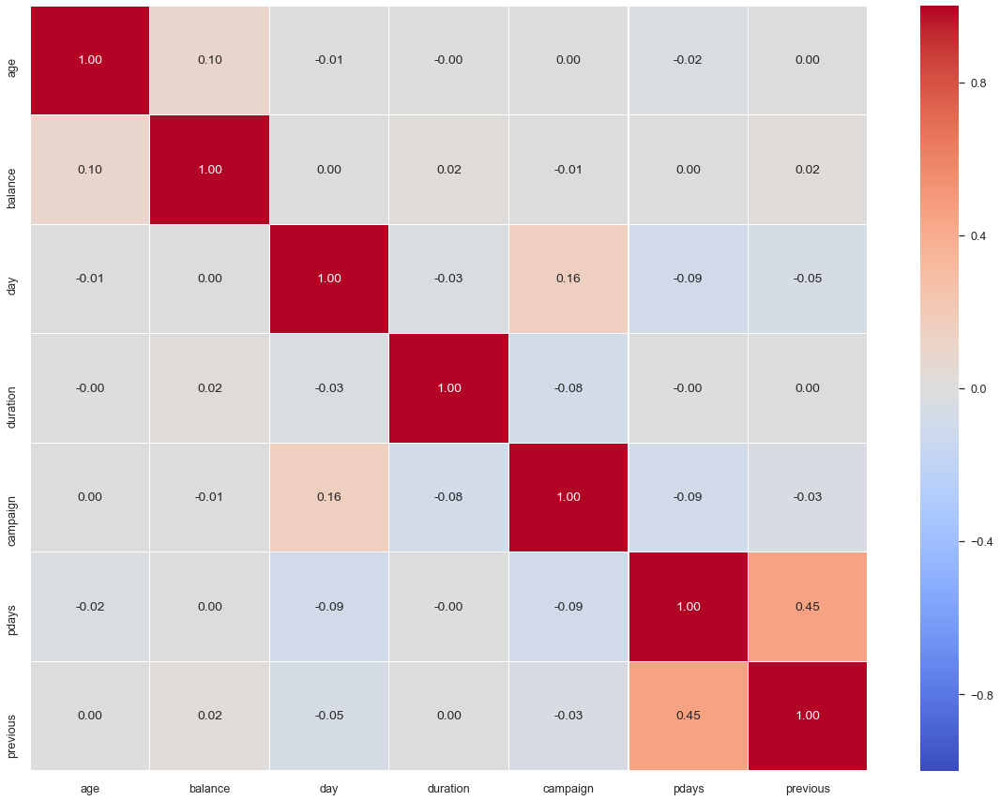

In [18]:
corr = dfM.corr()
plt.figure(figsize=[20,15])
sns.set(font_scale=1.15)
sns.heatmap(corr,annot=True,vmin=-1,vmax=1,center=0, linewidth=0.2, fmt='.2f', cmap='coolwarm')
plt.show()

### Inference
1. Besides the strong positive correlation between pdays and previous (as described earlier), there are no significant correlation between these features


<br>

### 'duration' feature analysis

In [19]:
fig = px.histogram(df, x='duration', marginal='box', color='target')
fig.show()

#### Observation : Median duration seems to be longer in conversion (target = yes)



<br>


In [20]:
# Converting duration from continuous variable to categorical variable by grouping them into buckets

durationbins=[0,50,77,100,125,150,180,215,260,320,410,600,5000]
durationlabels=['1-50','50-77','77-100','100-125','125-150','150-180','180-215','215-260','260-320','320-410','410-600','600+']

df['durationCat'] = pd.cut(df.duration, bins=durationbins,labels=durationlabels)

df.durationCat.value_counts()

150-180    4050
100-125    4030
215-260    3903
600+       3790
180-215    3769
410-600    3753
125-150    3697
320-410    3674
77-100     3667
260-320    3662
1-50       3608
50-77      3605
Name: durationCat, dtype: int64

### 'previous' feature analysis

In [21]:
fig = px.histogram(df[df.previous < 50], x='previous', marginal='box', color='target')
fig.show()

#### Observations : 
1. Ignoring the outliers, the 'previous' feature seem to be having the same kind of distribution of observations/data across both outcome groups.
2. From the violin chart below, there seems to be higher ratio of 'Zero contacts' in the conversion group (target = yes) 

<br>

In [22]:
fig = px.violin(df, color='target', y='previous', width=800)
fig.show()

In [23]:
df[df.previous == 0].target.value_counts()

no     33567
yes     3384
Name: target, dtype: int64

In [24]:
df[df.previous > 0].target.value_counts()

no     6352
yes    1905
Name: target, dtype: int64

In [25]:
# Converting previous from continuous variable to categorical variable by grouping them into buckets

previousbins=[-2,0,1,2,4,300]
previouslabels=['0','1','2','3-4','5+']

df['previousCat'] = pd.cut(df.previous, bins=previousbins,labels=previouslabels)

df.previousCat.value_counts().sort_values()

5+      1523
3-4     1856
2       2106
1       2772
0      36951
Name: previousCat, dtype: int64

### 'pdays' feature analysis

In [26]:
fig = px.histogram(df, x='pdays', marginal='box', color='target')
fig.show()

In [27]:
df[df.pdays == -1].target.value_counts()

no     33567
yes     3384
Name: target, dtype: int64

In [28]:
df[df.pdays > -1].target.value_counts()

no     6352
yes    1905
Name: target, dtype: int64

#### Comparing the ratio of 'pdays' for target=yes/no and 'previous' for target = yes/no, we can conclude these two are positively correlated. We can validate that with linear-scatter plot below
<br>

In [29]:
fig = px.scatter(df, x='previous', y='pdays', trendline="ols", width=600)
fig.show()

#### Given 'previous' and 'pdays' have a very strong linear correlation, we can drop one of these features - dropping 'pdays'  


<br>

In [30]:
df.drop('pdays',axis=1, inplace=True)

### 'campaign' feature analysis

In [31]:
fig = px.histogram(df, x='campaign', marginal='box', color='target')
fig.show()

#### 'Campaign' seems to have very similar distribution between the two outcome groups (target = yes/no)  


<br>

In [32]:
# Converting campaign from continuous variable to categorical variable by grouping them into buckets

campaignbins=[-1,1,2,3,5,70]
campaignlabels=['1','2','3','4-5','5+']

df['campaignCat'] = pd.cut(df.campaign, bins=campaignbins,labels=campaignlabels)

df.campaignCat.value_counts().sort_values()

5+      4354
4-5     5285
3       5521
2      12504
1      17544
Name: campaignCat, dtype: int64

### 'balance' feature analysis

In [33]:
fig = px.histogram(df, x='balance', marginal='box', color='target')
fig.show()

#### Having a negative balance in the account hasn't deterred from conversion, although the median for the data pertaining to positive conversion seems to be higher than the other group



<br>

In [34]:
# Converting balance from continuous variable to categorical variable by grouping them into buckets

balancebins=[-9000,-50,0,60,150,250,400,600,900,1400,2200,4000,103000]
balancelabels=['<(50)','(50)-0','0-60','60-150','150-250','250-400','400-600','600-900','900-1.4K','1.4K-2.2K','2.2K-4K','4K+']

df['balanceCat'] = pd.cut(df.balance, bins=balancebins,labels=balancelabels)

In [35]:
df.balanceCat.value_counts().sort_values()

<(50)        3176
150-250      3179
60-150       3455
0-60         3541
1.4K-2.2K    3678
4K+          3897
2.2K-4K      3903
400-600      3962
600-900      4026
(50)-0       4104
250-400      4112
900-1.4K     4175
Name: balanceCat, dtype: int64

### 'age' feature analysis

In [36]:
fig = px.histogram(df, x='age', marginal='box', color='target')
fig.show()

#### Similar pattern of data between the two outcome groups.



<br>

### 'day' feature analysis

In [37]:
fig = px.histogram(df, x='day', marginal='box', color='target')
fig.show()

#### Similar pattern of data between the two outcome groups.



<br>

## Deliverable – 2 (Prepare the data for analytics) – (10)
1. Ensure the attribute types are correct. If not, take appropriate actions.
2. Get the data model ready.
3. Transform the data i.e. scale / normalize if required
4. Create the training set and test set in ratio of 70:30

In [38]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 45208 entries, 0 to 45210
Data columns (total 20 columns):
age            45208 non-null int64
job            45208 non-null object
marital        45208 non-null object
education      45208 non-null object
default        45208 non-null object
balance        45208 non-null int64
housing        45208 non-null object
loan           45208 non-null object
contact        45208 non-null object
day            45208 non-null int64
month          45208 non-null object
duration       45208 non-null int64
campaign       45208 non-null int64
previous       45208 non-null int64
poutcome       45208 non-null object
target         45208 non-null object
durationCat    45208 non-null category
previousCat    45208 non-null category
campaignCat    45208 non-null category
balanceCat     45208 non-null category
dtypes: category(4), int64(6), object(10)
memory usage: 6.0+ MB


In [39]:
# With the addition of categorical variables, the original features are removed

df.drop(['duration','previous','campaign','balance'],axis=1, inplace=True)

In [40]:
# Categorical variables are converted from object datatype to category datatype 

for col in ['job','marital','education','default','housing','loan','contact','month','poutcome']:
    df[col] = df[col].astype('category')

In [41]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 45208 entries, 0 to 45210
Data columns (total 16 columns):
age            45208 non-null int64
job            45208 non-null category
marital        45208 non-null category
education      45208 non-null category
default        45208 non-null category
housing        45208 non-null category
loan           45208 non-null category
contact        45208 non-null category
day            45208 non-null int64
month          45208 non-null category
poutcome       45208 non-null category
target         45208 non-null object
durationCat    45208 non-null category
previousCat    45208 non-null category
campaignCat    45208 non-null category
balanceCat     45208 non-null category
dtypes: category(13), int64(2), object(1)
memory usage: 1.9+ MB


In [48]:
# Splitting the dependent variable from features

dfy = df.target.copy()
dfX = df.drop('target', axis=1)

In [49]:
# 1-hot-encoding the features / independent variables
dfX = pd.get_dummies(dfX)

In [50]:
dfX.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 45208 entries, 0 to 45210
Data columns (total 80 columns):
age                     45208 non-null int64
day                     45208 non-null int64
job_admin.              45208 non-null uint8
job_blue-collar         45208 non-null uint8
job_entrepreneur        45208 non-null uint8
job_housemaid           45208 non-null uint8
job_management          45208 non-null uint8
job_retired             45208 non-null uint8
job_self-employed       45208 non-null uint8
job_services            45208 non-null uint8
job_student             45208 non-null uint8
job_technician          45208 non-null uint8
job_unemployed          45208 non-null uint8
job_unknown             45208 non-null uint8
marital_divorced        45208 non-null uint8
marital_married         45208 non-null uint8
marital_single          45208 non-null uint8
education_primary       45208 non-null uint8
education_secondary     45208 non-null uint8
education_tertiary      45208 non-nu

In [51]:
# Convert dependent variable (outcome) to binary (0 & 1)
ymap = {'yes':1, 'no':0}

dfy = dfy.replace(ymap)
dfy.value_counts()

0    39919
1     5289
Name: target, dtype: int64

In [52]:
# Splitting the data for training

dfX_tr, dfX_ts, dfy_tr, dfy_ts = tts(dfX, dfy, test_size=0.3, random_state=6, stratify=dfy)

In [53]:
dfy_tr.value_counts(normalize=True)*100

0   88.3015
1   11.6985
Name: target, dtype: float64

In [54]:
dfy_ts.value_counts(normalize=True)*100

0   88.2990
1   11.7010
Name: target, dtype: float64

#### Managed to get equal distribution of outcome values in both training & testing split



<br>

## Deliverable – 3 (create the ensemble model) – (30)
1. First create models using Logistic Regression and Decision Tree algorithm. Note the model performance by using different matrices. Use confusion matrix to evaluate class level metrics i.e. Precision/Recall. Also reflect the accuracy and F1 score of the model. (10 marks)
2. Build the ensemble models (Bagging and Boosting) and note the model performance by using different matrices. Use same metrics as in above model. (at least 3 algorithms) (15 marks)
3. Make a DataFrame to compare models and their metrics. Give conclusion regarding the best algorithm and your reason behind it. (5 marks)

### 3a) Logistic Regression

In [55]:
from sklearn.linear_model import LogisticRegression
logit = LogisticRegression(solver='newton-cg')

In [56]:
logit.fit(dfX_tr,dfy_tr)
print('Training score : ',logit.score(dfX_tr, dfy_tr))

logit.fit(dfX_ts,dfy_ts)
print('Test score : ',logit.score(dfX_ts, dfy_ts))

Training score :  0.9001106019908358
Test score :  0.9028975890289759


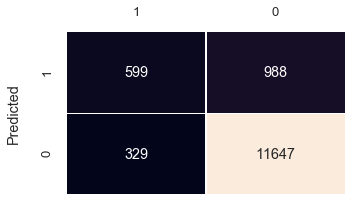

In [57]:
y_pred1 = logit.predict(dfX_ts)
cmat1 = mtr.confusion_matrix(dfy_ts,y_pred1, labels=[1,0])

dfcm1 = pd.DataFrame(cmat1, index=['1','0'],columns=['1','0'])
plt.figure(figsize=[5,3])
sns.set(font_scale=1.2)
fig = sns.heatmap(dfcm1, annot=True, fmt='d',linewidth=0.5, cbar=False)
plt.tick_params(axis='both', which='major', labelbottom = False, bottom=False, top = False, labeltop=True)
plt.ylabel('Predicted\n')
plt.show()

0.9086792694145186

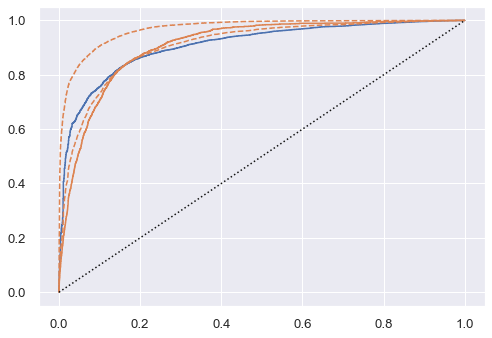

In [58]:
roc1 = ROCAUC(logit)
roc1.fit(dfX_tr, dfy_tr)
roc1.score(dfX_ts, dfy_ts)

In [59]:
# print classification report 
print(mtr.classification_report(dfy_ts,y_pred1))

rocauc1 = roc1.score(dfX_ts, dfy_ts)
prec1 = mtr.precision_score(dfy_ts, y_pred1, average='macro')
recl1 = mtr.recall_score(dfy_ts, y_pred1, average='macro')
f1scr1 = mtr.f1_score(dfy_ts, y_pred1, average='macro')
accr1 = mtr.accuracy_score(dfy_ts, y_pred1)

print('ROC-AUC (by scoring) : ',rocauc1)
print('Precision Macro : ',prec1)
print('Recall Macro : ',recl1)
print('F1 Macro : ',f1scr1)
print('Accuracy : ',accr1)

compare = pd.DataFrame('',index=['Precision Macro','Recall Macro','F1 Macro','Accuracy','ROC-AUC'],columns=['Logit','DecTree','Bagging','AdaBoost','GradBoost','RandomForest'])
compare.Logit = np.array([prec1,recl1,f1scr1,accr1,rocauc1])

              precision    recall  f1-score   support

           0       0.92      0.97      0.95     11976
           1       0.65      0.38      0.48      1587

    accuracy                           0.90     13563
   macro avg       0.78      0.67      0.71     13563
weighted avg       0.89      0.90      0.89     13563

ROC-AUC (by scoring) :  0.9086792694145186
Precision Macro :  0.7836393246046149
Recall Macro :  0.6749850520196031
F1 Macro :  0.7114146456840607
Accuracy :  0.9028975890289759


### 3b) Decision Tree

In [60]:
from sklearn.tree import DecisionTreeClassifier as dtc

In [56]:
param_grid = {
    'max_depth':[10,15,20,25,50]
}

grid = GridSearchCV(dtc(criterion='gini',splitter='best'),param_grid,refit=True, verbose=True, n_jobs=-1, scoring='recall_macro')
gfit = grid.fit(dfX_tr,dfy_tr)

# print best parameter after tuning 
print('Best Params : ',grid.best_params_)

# print classification report 
grid_predictions = grid.predict(dfX_ts) 
print(mtr.classification_report(dfy_ts, grid_predictions)) 

print("Best score: %0.3f" % gfit.best_score_)

Fitting 5 folds for each of 5 candidates, totalling 25 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  25 out of  25 | elapsed:    6.9s finished


Best Params :  {'max_depth': 20}
              precision    recall  f1-score   support

           0       0.93      0.94      0.93     11976
           1       0.50      0.48      0.49      1587

    accuracy                           0.88     13563
   macro avg       0.72      0.71      0.71     13563
weighted avg       0.88      0.88      0.88     13563

Best score: 0.699


Training Score :  0.9720018960341286
Test Score :  0.882769298827693


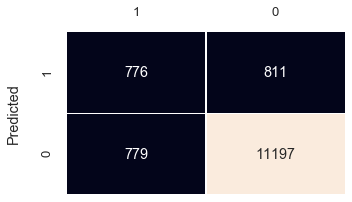

In [61]:
dtree = dtc(criterion='gini',splitter='best',max_depth=20 )

dtree.fit(dfX_tr, dfy_tr)
print('Training Score : ',dtree.score(dfX_tr, dfy_tr))
print('Test Score : ',dtree.score(dfX_ts, dfy_ts))

y_pred2 = dtree.predict(dfX_ts)
cmat2 = mtr.confusion_matrix(dfy_ts,y_pred2, labels=[1,0])
dfcm2 = pd.DataFrame(cmat2, index=['1','0'],columns=['1','0'])
plt.figure(figsize=[5,3])
sns.set(font_scale=1.2)
fig = sns.heatmap(dfcm2, annot=True, fmt='d',linewidth=0.5, cbar=False)
plt.tick_params(axis='both', which='major', labelbottom = False, bottom=False, top = False, labeltop=True)
plt.ylabel('Predicted\n')
plt.show()

0.688007149096539

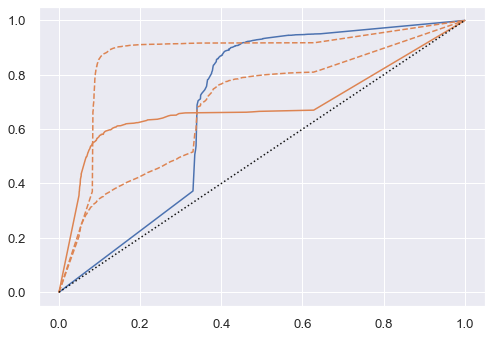

In [62]:
roc2 = ROCAUC(dtree)
roc2.fit(dfX_tr, dfy_tr)
roc2.score(dfX_ts, dfy_ts)

In [63]:
# print classification report 
print(mtr.classification_report(dfy_ts,y_pred2))

rocauc2 = roc2.score(dfX_ts, dfy_ts)
prec2 = mtr.precision_score(dfy_ts, y_pred2, average='macro')
recl2 = mtr.recall_score(dfy_ts, y_pred2, average='macro')
f1scr2 = mtr.f1_score(dfy_ts, y_pred2, average='macro')
accr2 = mtr.accuracy_score(dfy_ts, y_pred2)

print('ROC-AUC (by scoring) : ',rocauc2)
print('Precision Macro : ',prec2)
print('Recall Macro : ',recl2)
print('F1 Macro : ',f1scr2)
print('Accuracy : ',accr2)

compare.DecTree = np.array([prec2,recl2,f1scr2,accr2,rocauc2])
# compare

              precision    recall  f1-score   support

           0       0.93      0.93      0.93     11976
           1       0.50      0.49      0.49      1587

    accuracy                           0.88     13563
   macro avg       0.72      0.71      0.71     13563
weighted avg       0.88      0.88      0.88     13563

ROC-AUC (by scoring) :  0.688007149096539
Precision Macro :  0.7157485309900581
Recall Macro :  0.7119630723324406
F1 Macro :  0.7138293500568382
Accuracy :  0.882769298827693


### 3c) Bagging

In [64]:
from sklearn.ensemble import BaggingClassifier

In [276]:
param_grid = {
    'n_estimators':[9,11,13,15],
    'max_features':[60,70,80,90]
}

grid = GridSearchCV(BaggingClassifier(max_samples=25000),param_grid,refit=True, verbose=True, n_jobs=-1, scoring='recall_macro')
gfit = grid.fit(dfX_tr,dfy_tr)

# print best parameter after tuning 
print('Best Params : ',grid.best_params_)

# print classification report 
grid_predictions = grid.predict(dfX_ts) 
print(mtr.classification_report(dfy_ts, grid_predictions)) 

print("Best score: %0.3f" % gfit.best_score_)


Fitting 5 folds for each of 16 candidates, totalling 80 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  34 tasks      | elapsed:   24.4s
[Parallel(n_jobs=-1)]: Done  80 out of  80 | elapsed:   40.1s finished


Best Params :  {'max_features': 80, 'n_estimators': 13}
              precision    recall  f1-score   support

           0       0.93      0.96      0.94     11976
           1       0.58      0.45      0.50      1587

    accuracy                           0.90     13563
   macro avg       0.75      0.70      0.72     13563
weighted avg       0.89      0.90      0.89     13563

Best score: 0.704


Training Score :  0.9900774213935851
Test Score :  0.8944923689449237


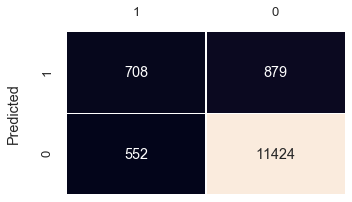

In [65]:
bgcl = BaggingClassifier(max_features=80, max_samples=25000, n_estimators=13)
bgcl = bgcl.fit(dfX_tr, dfy_tr)

print('Training Score : ',bgcl.score(dfX_tr, dfy_tr))
print('Test Score : ',bgcl.score(dfX_ts, dfy_ts))


y_pred3 = bgcl.predict(dfX_ts)
cmat3 = mtr.confusion_matrix(dfy_ts,y_pred3, labels=[1,0])
dfcm3 = pd.DataFrame(cmat3, index=['1','0'],columns=['1','0'])
plt.figure(figsize=[5,3])
sns.set(font_scale=1.2)
fig = sns.heatmap(dfcm3, annot=True, fmt='d',linewidth=0.5, cbar=False)
plt.tick_params(axis='both', which='major', labelbottom = False, bottom=False, top = False, labeltop=True)
plt.ylabel('Predicted\n')
plt.show()

0.8903638509954166

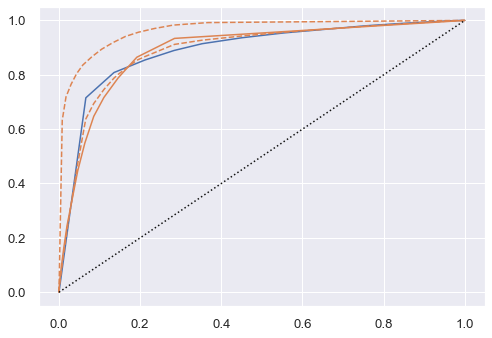

In [66]:
roc3 = ROCAUC(bgcl)
roc3.fit(dfX_tr, dfy_tr)
roc3.score(dfX_ts, dfy_ts)

In [67]:
# print classification report 
print(mtr.classification_report(dfy_ts,y_pred3))

rocauc3 = roc3.score(dfX_ts, dfy_ts)
prec3 = mtr.precision_score(dfy_ts, y_pred3, average='macro')
recl3 = mtr.recall_score(dfy_ts, y_pred3, average='macro')
f1scr3 = mtr.f1_score(dfy_ts, y_pred3, average='macro')
accr3 = mtr.accuracy_score(dfy_ts, y_pred3)

print('ROC-AUC (by scoring) : ',rocauc3)
print('Precision Macro : ',prec3)
print('Recall Macro : ',recl3)
print('F1 Macro : ',f1scr3)
print('Accuracy : ',accr3)

compare.Bagging = np.array([prec3,recl3,f1scr3,accr3,rocauc3])
# compare

              precision    recall  f1-score   support

           0       0.93      0.95      0.94     11976
           1       0.56      0.45      0.50      1587

    accuracy                           0.89     13563
   macro avg       0.75      0.70      0.72     13563
weighted avg       0.89      0.89      0.89     13563

ROC-AUC (by scoring) :  0.8903638509954166
Precision Macro :  0.7452293865607691
Recall Macro :  0.7000162896681832
F1 Macro :  0.7192129117554269
Accuracy :  0.8944923689449237


### 3d) AdaBoost

In [68]:
from sklearn.ensemble import AdaBoostClassifier

dtr3 = dtc(criterion='gini',splitter='best',max_depth=3)
dtr4 = dtc(criterion='gini',splitter='best',max_depth=4)
dtr5 = dtc(criterion='gini',splitter='best',max_depth=5)


In [65]:
param_grid = {
    'learning_rate':[0.9,1.0,1.1,1.2,1.5],
    'n_estimators':[40,50,75]
}

grid = GridSearchCV(AdaBoostClassifier(base_estimator=dtr4,algorithm='SAMME.R'),param_grid,refit=True, verbose=True, n_jobs=-1, scoring='recall_macro')
gfit = grid.fit(dfX_tr,dfy_tr)

# print best parameter after tuning 
print('Best Params : ',grid.best_params_)

# print classification report 
grid_predictions = grid.predict(dfX_ts) 
print(mtr.classification_report(dfy_ts, grid_predictions)) 

print("Best score: %0.3f" % gfit.best_score_)


Fitting 5 folds for each of 15 candidates, totalling 75 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  34 tasks      | elapsed:   36.4s
[Parallel(n_jobs=-1)]: Done  75 out of  75 | elapsed:  1.4min finished


Best Params :  {'learning_rate': 1.0, 'n_estimators': 50}
              precision    recall  f1-score   support

           0       0.93      0.96      0.94     11976
           1       0.58      0.46      0.51      1587

    accuracy                           0.90     13563
   macro avg       0.75      0.71      0.73     13563
weighted avg       0.89      0.90      0.89     13563

Best score: 0.715


Training Score :  0.9245694422499605
Test Score :  0.8969254589692546


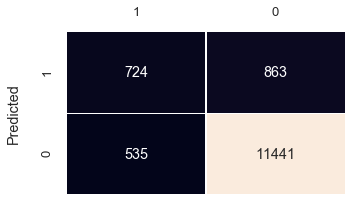

In [69]:

abcl = AdaBoostClassifier(base_estimator=dtr4,algorithm='SAMME.R',learning_rate=1.0,n_estimators=50)

abcl = abcl.fit(dfX_tr, dfy_tr)
print('Training Score : ',abcl.score(dfX_tr, dfy_tr))
print('Test Score : ',abcl.score(dfX_ts, dfy_ts))

y_pred4 = abcl.predict(dfX_ts)
cmat4 = mtr.confusion_matrix(dfy_ts,y_pred4, labels=[1,0])
dfcm4 = pd.DataFrame(cmat4, index=['1','0'],columns=['1','0'])
plt.figure(figsize=[5,3])
sns.set(font_scale=1.2)
fig = sns.heatmap(dfcm4, annot=True, fmt='d',linewidth=0.5, cbar=False)
plt.tick_params(axis='both', which='major', labelbottom = False, bottom=False, top = False, labeltop=True)
plt.ylabel('Predicted\n')
plt.show()

0.8960144412580744

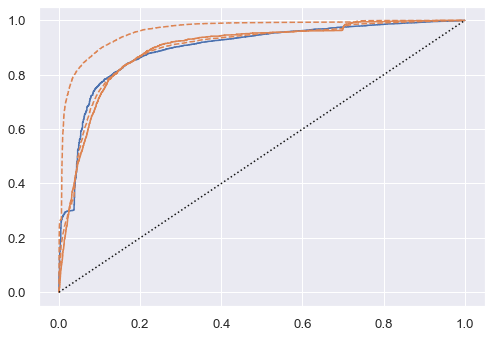

In [70]:
roc4 = ROCAUC(abcl)
roc4.fit(dfX_tr, dfy_tr)
roc4.score(dfX_ts, dfy_ts)

In [71]:
# print classification report 
print(mtr.classification_report(dfy_ts,y_pred4))

rocauc4 = roc4.score(dfX_ts, dfy_ts)
prec4 = mtr.precision_score(dfy_ts, y_pred4, average='macro')
recl4 = mtr.recall_score(dfy_ts, y_pred4, average='macro')
f1scr4 = mtr.f1_score(dfy_ts, y_pred4, average='macro')
accr4 = mtr.accuracy_score(dfy_ts, y_pred4)

print('ROC-AUC (by scoring) : ',rocauc4)
print('Precision Macro : ',prec4)
print('Recall Macro : ',recl4)
print('F1 Macro : ',f1scr4)
print('Accuracy : ',accr4)

compare.AdaBoost = np.array([prec4,recl4,f1scr4,accr4,rocauc4])
# compare

              precision    recall  f1-score   support

           0       0.93      0.96      0.94     11976
           1       0.58      0.46      0.51      1587

    accuracy                           0.90     13563
   macro avg       0.75      0.71      0.73     13563
weighted avg       0.89      0.90      0.89     13563

ROC-AUC (by scoring) :  0.8960144412580744
Precision Macro :  0.752459889575292
Recall Macro :  0.7057670002891732
F1 Macro :  0.7256030024509095
Accuracy :  0.8969254589692546


### 3e) Gradient Boosting

In [72]:
from sklearn.ensemble import GradientBoostingClassifier

In [ ]:
param_grid = {
#     'loss':['deviance', 'exponential'],
    'learning_rate':[0.05,0.1,0.5],
    'n_estimators':[40,50,60],
    'subsample':[0.1,0.5,1.0],
#     'criterion' : ['friedman_mse', 'mse', 'mae'],
    'max_depth':[10,20,50],
    'min_impurity_decrease':[0.001,0.1,0.2]
#     'max_features':['auto', 'sqrt', 'log2']
}

grid = GridSearchCV(GradientBoostingClassifier(criterion='friedman_mse',loss='deviance',max_features='auto'),param_grid,refit=True, verbose=True, n_jobs=-1, scoring='recall_macro')
gfit = grid.fit(dfX_tr,dfy_tr)

# print best parameter after tuning 
print('Best Params : ',grid.best_params_)

# print classification report 
grid_predictions = grid.predict(dfX_ts) 
print(mtr.classification_report(dfy_ts, grid_predictions)) 

print("Best score: %0.3f" % gfit.best_score_)


Fitting 5 folds for each of 243 candidates, totalling 1215 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  34 tasks      | elapsed:   45.2s


Training Score :  0.907821140780534
Test Score :  0.9020865590208655


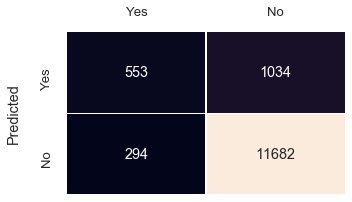

In [73]:
gbcl = GradientBoostingClassifier(criterion='friedman_mse', learning_rate=0.1, loss='exponential', max_depth=5, max_features='auto', min_impurity_decrease=0.2, n_estimators=60, subsample=0.2)
gbcl = gbcl.fit(dfX_tr, dfy_tr)

print('Training Score : ',gbcl.score(dfX_tr, dfy_tr))
print('Test Score : ',gbcl.score(dfX_ts, dfy_ts))

y_pred5 = gbcl.predict(dfX_ts)
cmat5 = mtr.confusion_matrix(dfy_ts,y_pred5, labels=[1,0])
dfcm5 = pd.DataFrame(cmat5, index=['Yes','No'],columns=['Yes','No'])
plt.figure(figsize=[5,3])
sns.set(font_scale=1.2)
fig = sns.heatmap(dfcm5, annot=True, fmt='d',linewidth=0.5, cbar=False)
plt.tick_params(axis='both', which='major', labelbottom = False, bottom=False, top = False, labeltop=True)
plt.ylabel('Predicted\n')
plt.show()

0.9195840560396664

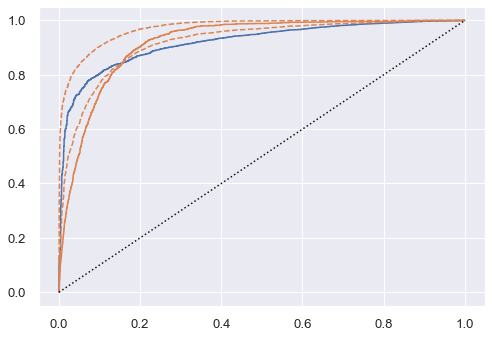

In [74]:
roc5 = ROCAUC(gbcl)
roc5.fit(dfX_tr, dfy_tr)
roc5.score(dfX_ts, dfy_ts)

In [75]:
# print classification report 
print(mtr.classification_report(dfy_ts,y_pred5))

rocauc5 = roc5.score(dfX_ts, dfy_ts)
prec5 = mtr.precision_score(dfy_ts, y_pred5, average='macro')
recl5 = mtr.recall_score(dfy_ts, y_pred5, average='macro')
f1scr5 = mtr.f1_score(dfy_ts, y_pred5, average='macro')
accr5 = mtr.accuracy_score(dfy_ts, y_pred5)

print('ROC-AUC (by scoring) : ',rocauc5)
print('Precision Macro : ',prec5)
print('Recall Macro : ',recl5)
print('F1 Macro : ',f1scr5)
print('Accuracy : ',accr4)

compare.GradBoost = np.array([prec5,recl5,f1scr5,accr5,rocauc5])
# compare

              precision    recall  f1-score   support

           0       0.92      0.98      0.95     11976
           1       0.65      0.35      0.45      1587

    accuracy                           0.90     13563
   macro avg       0.79      0.66      0.70     13563
weighted avg       0.89      0.90      0.89     13563

ROC-AUC (by scoring) :  0.9195840560396664
Precision Macro :  0.7857888415453688
Recall Macro :  0.6619535542414381
F1 Macro :  0.7003067271113728
Accuracy :  0.8969254589692546


### 3f) RandomForest

In [76]:
from sklearn.ensemble import RandomForestClassifier

In [327]:
param_grid = {
    'n_estimators':[60,70,80,90,100,120,150],
    'max_depth':[10,15,20,30,40,50]
}

grid = GridSearchCV(RandomForestClassifier(criterion='gini', class_weight='balanced', max_features='auto', min_impurity_decrease=0.001),param_grid,refit=True, verbose=True, n_jobs=-1, scoring='recall_macro')
gfit = grid.fit(dfX_tr,dfy_tr)

# print best parameter after tuning 
print('Best Params : ',grid.best_params_)

# print classification report 
grid_predictions = grid.predict(dfX_ts) 
print(mtr.classification_report(dfy_ts, grid_predictions)) 

print("Best score: %0.3f" % gfit.best_score_)


Fitting 5 folds for each of 42 candidates, totalling 210 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 8 concurrent workers.
[Parallel(n_jobs=-1)]: Done  34 tasks      | elapsed:   10.2s
[Parallel(n_jobs=-1)]: Done 184 tasks      | elapsed:   55.1s
[Parallel(n_jobs=-1)]: Done 210 out of 210 | elapsed:  1.1min finished


Best Params :  {'max_depth': 20, 'n_estimators': 80}
              precision    recall  f1-score   support

           0       0.97      0.84      0.90     11976
           1       0.40      0.83      0.54      1587

    accuracy                           0.84     13563
   macro avg       0.69      0.83      0.72     13563
weighted avg       0.91      0.84      0.86     13563

Best score: 0.839


Training Score :  0.8366566598198768
Test Score :  0.8341812283418123


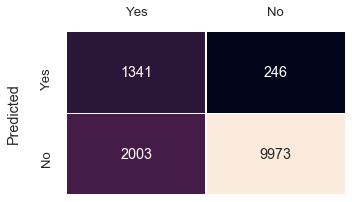

In [77]:
rfcl = RandomForestClassifier(criterion='gini', class_weight='balanced', max_features='auto', min_impurity_decrease=0.001, max_depth=20, n_estimators=80)
rfcl = rfcl.fit(dfX_tr, dfy_tr)

print('Training Score : ',rfcl.score(dfX_tr, dfy_tr))
print('Test Score : ',rfcl.score(dfX_ts, dfy_ts))

y_pred6 = rfcl.predict(dfX_ts)
cmat6 = mtr.confusion_matrix(dfy_ts,y_pred6, labels=[1,0])
dfcm6 = pd.DataFrame(cmat6, index=['Yes','No'],columns=['Yes','No'])
plt.figure(figsize=[5,3])
sns.set(font_scale=1.2)
fig = sns.heatmap(dfcm6, annot=True, fmt='d',linewidth=0.5, cbar=False)
plt.tick_params(axis='both', which='major', labelbottom = False, bottom=False, top = False, labeltop=True)
plt.ylabel('Predicted\n')
plt.show()

0.9043972796603378

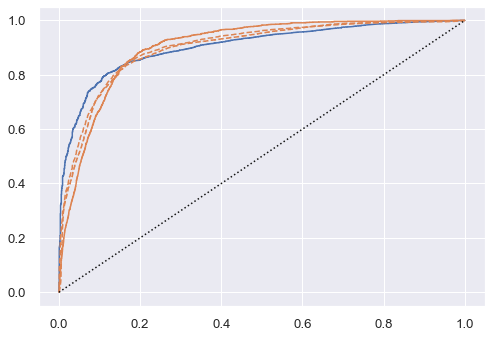

In [78]:
roc6 = ROCAUC(rfcl)
roc6.fit(dfX_tr, dfy_tr)
roc6.score(dfX_ts, dfy_ts)

In [79]:
# print classification report 
print(mtr.classification_report(dfy_ts,y_pred6))

rocauc6 = roc6.score(dfX_ts, dfy_ts)
prec6 = mtr.precision_score(dfy_ts, y_pred6, average='macro')
recl6 = mtr.recall_score(dfy_ts, y_pred6, average='macro')
f1scr6 = mtr.f1_score(dfy_ts, y_pred6, average='macro')
accr6 = mtr.accuracy_score(dfy_ts, y_pred6)

print('ROC-AUC (by scoring) : ',rocauc6)
print('Precision Macro : ',prec6)
print('Recall Macro : ',recl6)
print('F1 Macro : ',f1scr6)
print('Accuracy : ',accr6)

compare.RandomForest = np.array([prec6,recl6,f1scr6,accr6,rocauc6])
compare

              precision    recall  f1-score   support

           0       0.98      0.83      0.90     11976
           1       0.40      0.84      0.54      1587

    accuracy                           0.83     13563
   macro avg       0.69      0.84      0.72     13563
weighted avg       0.91      0.83      0.86     13563

ROC-AUC (by scoring) :  0.9043972796603378
Precision Macro :  0.6884719704266047
Recall Macro :  0.8388696895997414
F1 Macro :  0.7212883866289237
Accuracy :  0.8341812283418123


,Logit,DecTree,Bagging,AdaBoost,GradBoost,RandomForest
Precision Macro,0.7836,0.7157,0.7452,0.7525,0.7858,0.6885
Recall Macro,0.6750,0.7120,0.7000,0.7058,0.6620,0.8389
F1 Macro,0.7114,0.7138,0.7192,0.7256,0.7003,0.7213
Accuracy,0.9029,0.8828,0.8945,0.8969,0.9021,0.8342
ROC-AUC,0.9087,0.6880,0.8904,0.8960,0.9196,0.9044


In [80]:
cmpr = compare.T
cmpr = compare.reset_index()
cmpr = cmpr.melt(id_vars='index',value_vars=['Logit','DecTree','Bagging','AdaBoost','GradBoost','RandomForest'], var_name='Model',value_name='Value')
# cmpr

fig = px.line(cmpr, x='Model', y='Value', color='index', range_y=[0.6,1.0], width=900, height=600)
fig.data[0].update(mode='markers+lines')
fig.data[1].update(mode='markers+lines')
fig.data[2].update(mode='markers+lines')
fig.data[3].update(mode='markers+lines')
fig.data[4].update(mode='markers+lines')
fig.show()

## Summary

1. Given the objective (per the problem statement) is to "increase their hit ratio" - as I understand it to be increasing the ratio of True Positives among the consumers who are likely to subscribe to term deposit - the focus is on building/tuning a model to yield a higher Recall metric. 
2. Recall_Macro is assumed to be the right metric in order not to be encumbered with an imbalanced dataset.
3. Comparison chart above shows the metrics of the six models built, **Random Forest has the highest Recall_Macro score and ROC_AUC score** and would be the right choice for predictions in this usecase  